# work flow on ZTF Ic-BL objects

### import packages

In [1]:
import sys
sys.path.append('../sdapy')
from ztfanalysis import *
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from astropy.cosmology import Planck13 as cosmo
from filters import *
from models import *
plt.rcParams["text.usetex"] = False

### ZTF names for the project

In [3]:
# Shreya list
snlist1 = ['ZTF18acpeekw', 'ZTF18acbwxcc', 'ZTF18acaimrb',
          'ZTF18abklarx', 'ZTF20aazkjfv', 'ZTF21aafnunh',
          'ZTF18acqphpd', 'ZTF18aczqzrj', 'ZTF19aawqcgy',
          'ZTF19aaxfcpq', 'ZTF19ablesob', 'ZTF19abzwaen',
          'ZTF20abswdbg', 'ZTF20aapcbmc', 'ZTF20abbplei',
          'ZTF20abzoeiw', 'ZTF21aadatfg', 'ZTF21aagtpro',
          'ZTF21abmjgwf', 'ZTF21acbnfos']
         
# Alessandra list
snlist2 =['ZTF18abklarx', 'ZTF18acaimrb', 'ZTF18acbwxcc',
         'ZTF18achdzwk', 'ZTF18acpeekw', 'ZTF19aawqcgy', 
         'ZTF19adaiomg', 'ZTF20aazkjfv', 'ZTF20abbplei', 
         'ZTF20abswdbg', 'ZTF20abzoeiw', #'ZTF20adadrhw',
         'ZTF21aadatfg', 'ZTF21aafnunh', 'ZTF21acbnfos',
         'ZTF21aaocrlm', 'ZTF21aardvol', 'ZTF21aartgiv']

In [4]:
# Shreya list
velocities1 = {}
velfile = '/Users/yash0613/Desktop/singleobj_study/ztficbl/absolute_velocities_IcBL_Shreya.txt'
for nn,ll in enumerate(open(velfile).readlines()):
    if nn == 0:continue
    snname = ll.split()[0]
    snphase = float(ll.split()[1])
    tempphase = float(ll.split()[2])
    v = float(ll.split()[3])
    verr = float(ll.split()[4])
    velocities1[snname] = [snphase,v,verr]

In [5]:
# Alessandra list
velocities2 = {}
velfile = '/Users/yash0613/Desktop/singleobj_study/ztficbl/absolute_velocities_IcBL.txt'
for nn,ll in enumerate(open(velfile).readlines()):
    if nn == 0:continue
    snname = ll.split()[0]
    snphase = float(ll.split()[1])
    tempphase = float(ll.split()[2])
    v = float(ll.split()[3])
    verr = float(ll.split()[4])
    velocities2[snname] = [snphase,v,verr]

In [6]:
snlist = list(np.unique(snlist1 + snlist2))
len(snlist)

25

### fun ztfmultiple to parse meta from bts catalog

In [7]:
ztfpm = ztfmultiple(metafile='rcf_query.txt', 
                    datafile='%s_data.clf',
                    parfile='priors.txt',
                    datadir='/Users/yash0613/Desktop/singleobj_study/ztficbl/',
                    skiprows=[], )
ztfpm.parse_meta(syntax='ZTFID in %s'%snlist)

meta 21 objs


### check if sn are missed by bts cat

In [8]:
for _ in snlist:
    if not _ in list(ztfpm.meta['ZTFID']): print (_)

ZTF18achdzwk
ZTF18acpeekw
ZTF19adaiomg
ZTF21aardvol


### manually add infos for the missing one

In [9]:
ztfpm.meta = ztfpm.meta.append({'ZTFID':'ZTF18acpeekw','IAUID': 'AT2018jex', 'RA': '11:54:13.876', 
                    'Dec':'20:44:2.525', 'type': 'SN Ic-BL','redshift': 0.087, 'A_V': 0.123}, ignore_index=True)
ztfpm.meta = ztfpm.meta.append({'ZTFID':'ZTF19adaiomg','IAUID': 'SN2019xcc', 'RA': '11:01:12.39', 
                    'Dec':'+16:43:29.1', 'type': 'SN Ic-BL','redshift': 0.0287, 'A_V': 0.052}, ignore_index=True)
ztfpm.meta = ztfpm.meta.append({'ZTFID':'ZTF18achdzwk','IAUID': 'SN2018ium', 'RA': '10:10:31.76', 
                    'Dec':'+10:02:39.2', 'type': 'SN Ic-BL','redshift': 0.03167, 'A_V': 0.119}, ignore_index=True)
ztfpm.meta = ztfpm.meta.append({'ZTFID':'ZTF21aardvol','IAUID': 'AT2021htb', 'RA': '07:45:31.19', 
                    'Dec':'46:40:01.39', 'type': 'SN Ic-BL','redshift': 0.032, 'A_V': 0.182}, ignore_index=True)
ztfpm.format_meta()

# for all objs

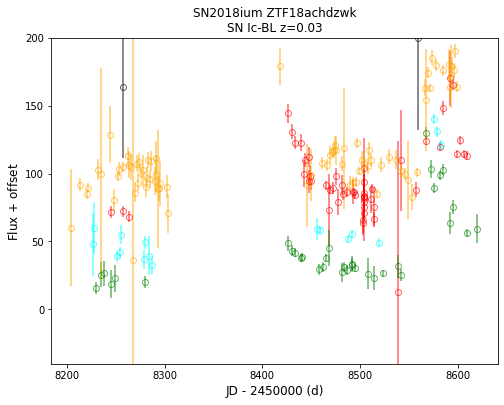

In [10]:
par = {
    'plot_bands': ['r','g','i', 'c','o'],
    'ax_xlim': [-160,160],
    'ax_ylim': [-40,200],
    'pl_type': 0,
    'pl_bands': ['o','r','g', 'i'],
    'nsteps': 40000,
    'nsteps_burnin': 20000,
    'rel_flux_cutoff': .4,
    'verbose': True,
    'nwalkers'  : 50,
    'tm_pl': 100,
    #'gp_fitr': [-100,100],
    #'gp_plotr': [-100,100],
}
nsn = 23
ztfp = ztfsingle(ztfid=ztfpm.meta.iloc[nsn]._name, iauid=ztfpm.meta.iloc[nsn]['IAUID'], 
                 z=ztfpm.meta.iloc[nsn]['redshift'], dm=ztfpm.meta.iloc[nsn]['dm'], 
                 mkwebv=ztfpm.meta.iloc[nsn]['ebv'], sntype=ztfpm.meta.iloc[nsn]['type'], 
                 ra=ztfpm.meta.iloc[nsn]['RA'], dec=ztfpm.meta.iloc[nsn]['Dec'], 
                 jdpeak=ztfpm.meta.iloc[nsn]['peakt']+2458000, **par)

if False:
    ztfp.query_fp_atlas(wdir='/Users/yash0613/Desktop/scripts/sn_data_analysis/sdapy/',
                    clobber=True, verbose=True, mjdstart=58200, mjdend=58600)
    
if True:
    ztfp.get_fp_ztf()
    ztfp.get_fp_atlas(binDays=1, clobber=False, verbose=True)
    #ztfp.run_gp()
    #ztfp.set_t0_withgp() 
    #ztfp.set_texp_midway()
    if False:
        fig,ax=plt.subplots(1,1)
        ztfp.calibrate_baseline(ax=ax, key='fcqfid', source='ztffp',
                    xmin=-100, xmax=-20, ax_xlim=None, ax_ylim=None)
    if True:
        ztfp.fig, ztfp.ax = plt.subplots(1,1)
        #ztfp.explosion_pl(ext_filt=['r','g','i','o'],ext_num=10)
        ztfp.plot(figsize=(8,6))

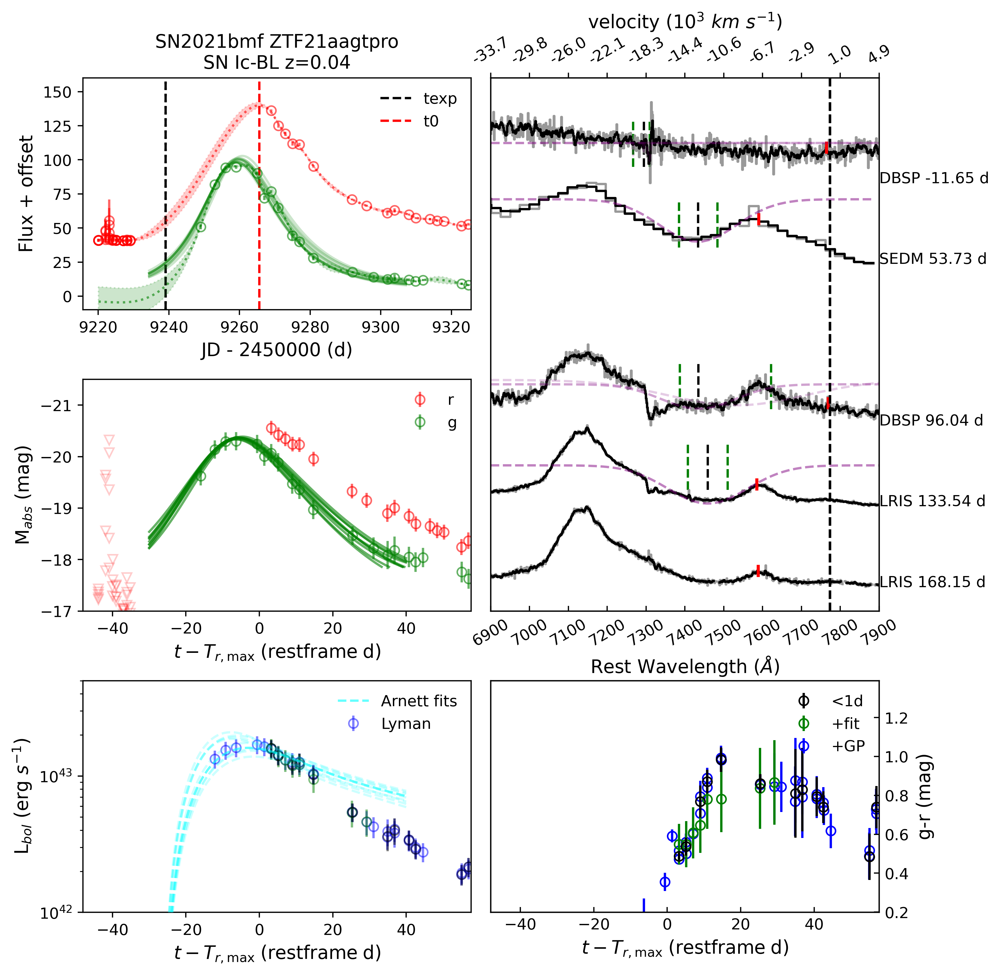

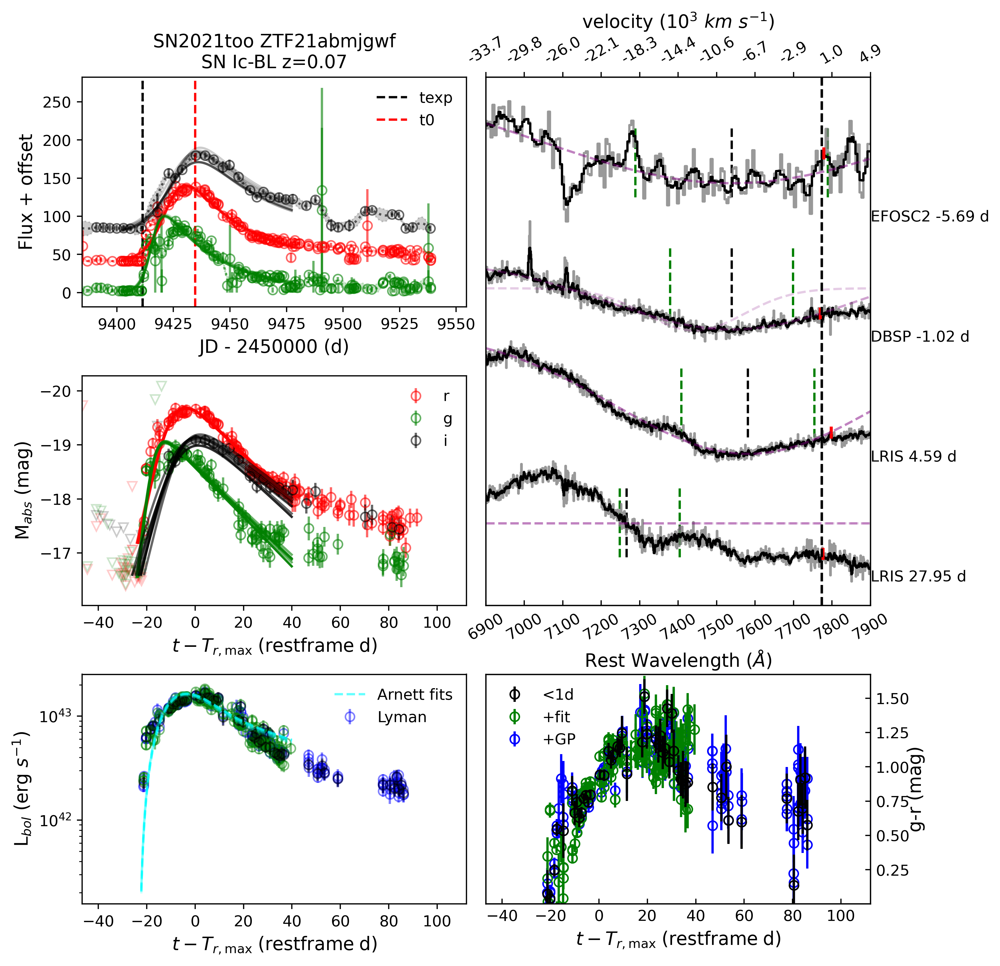

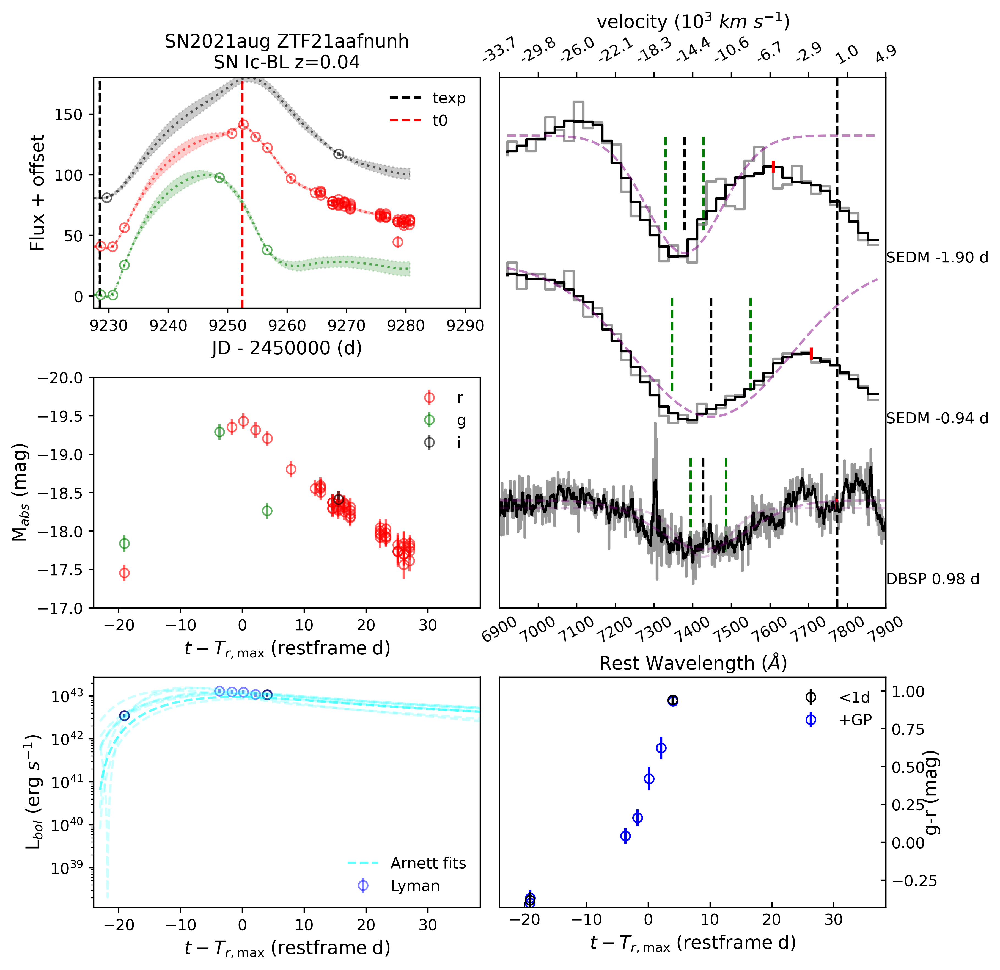

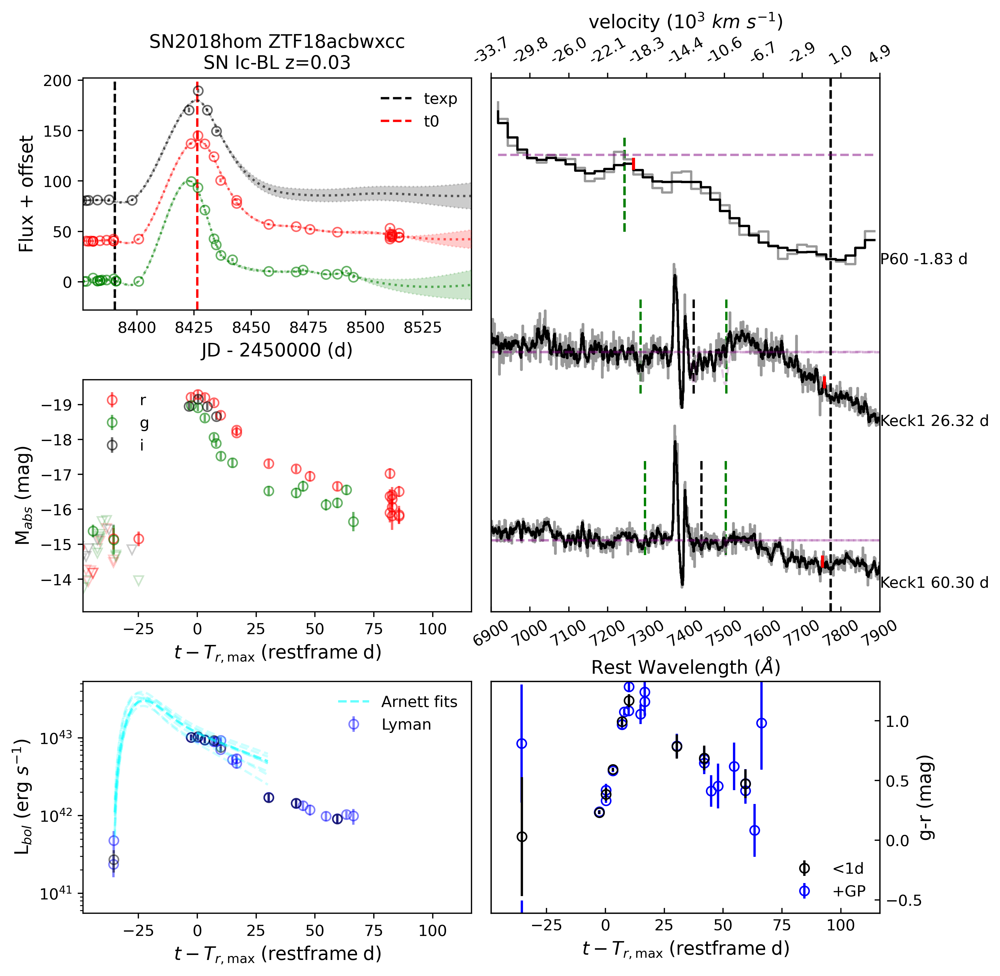

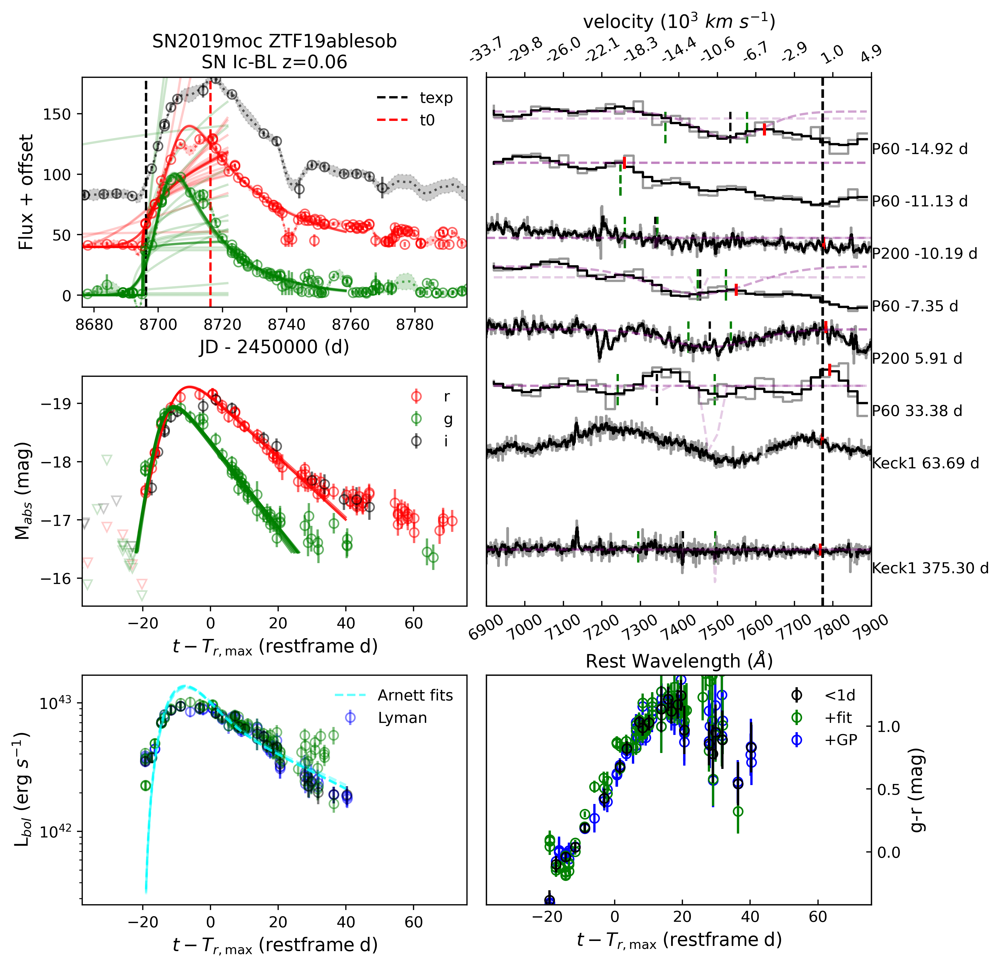

...

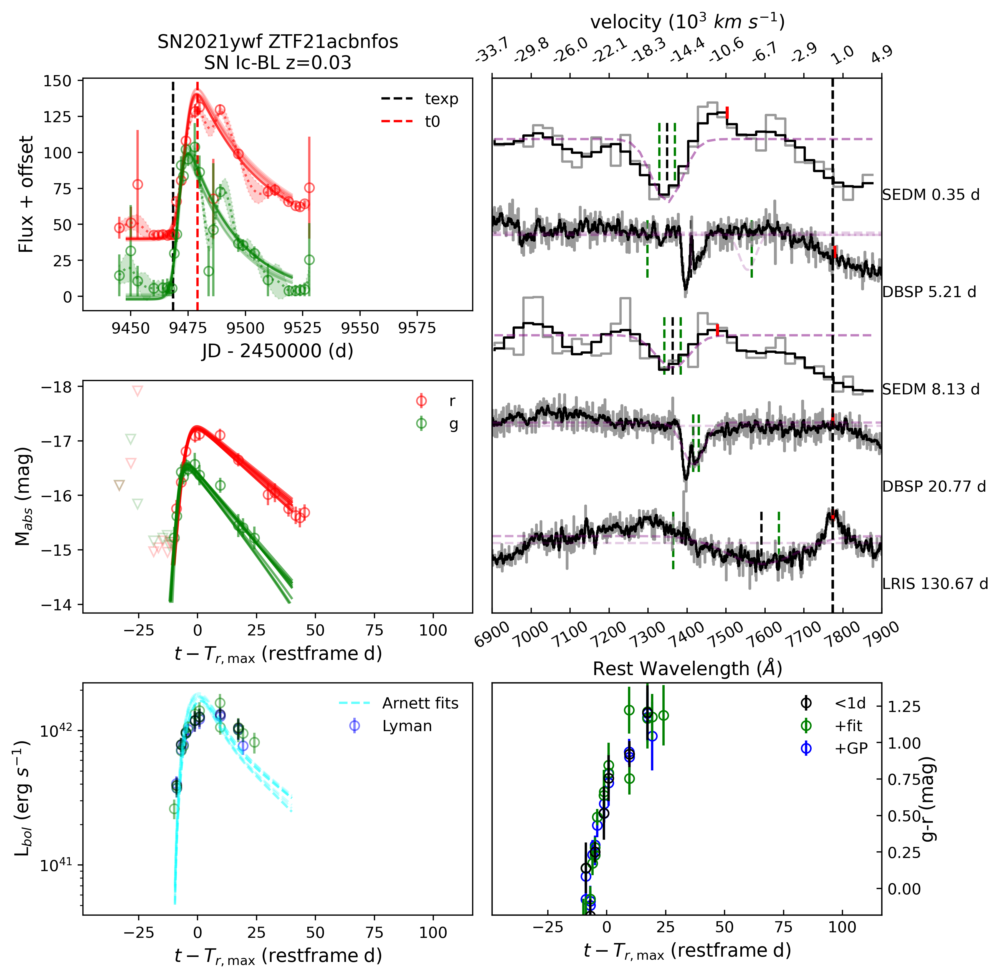

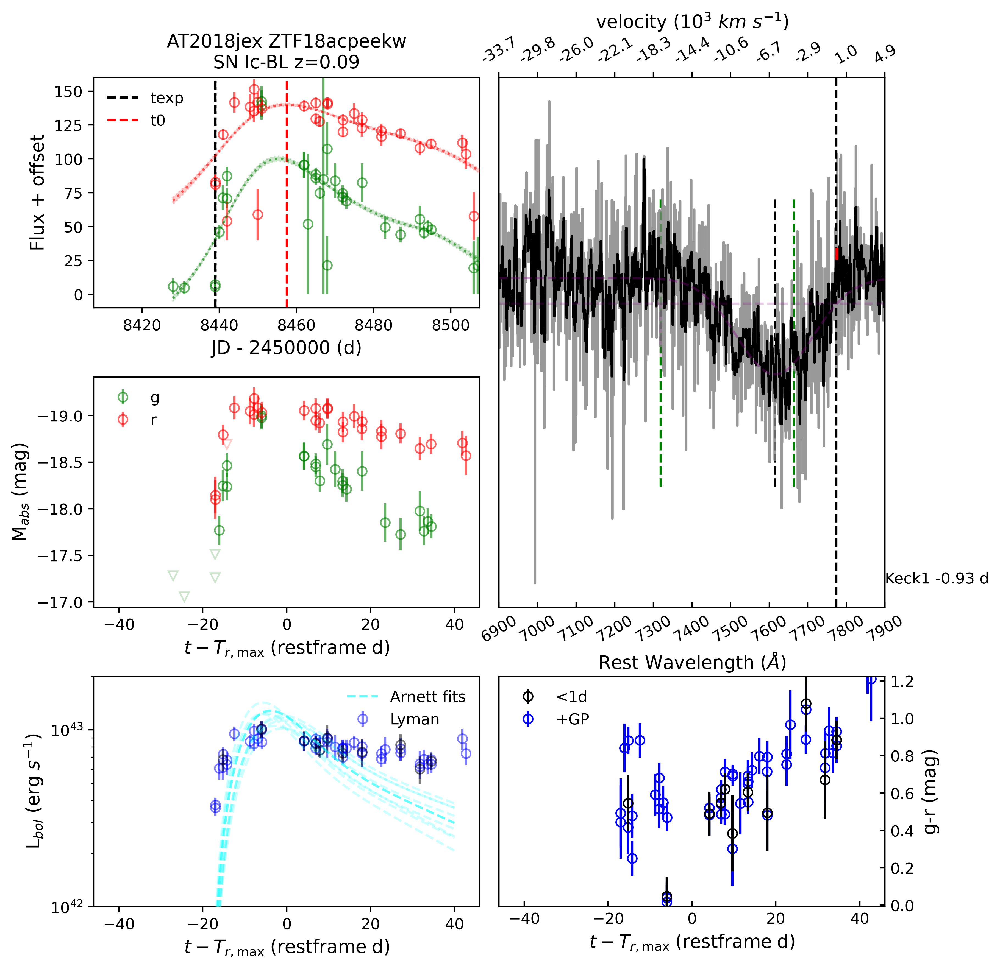

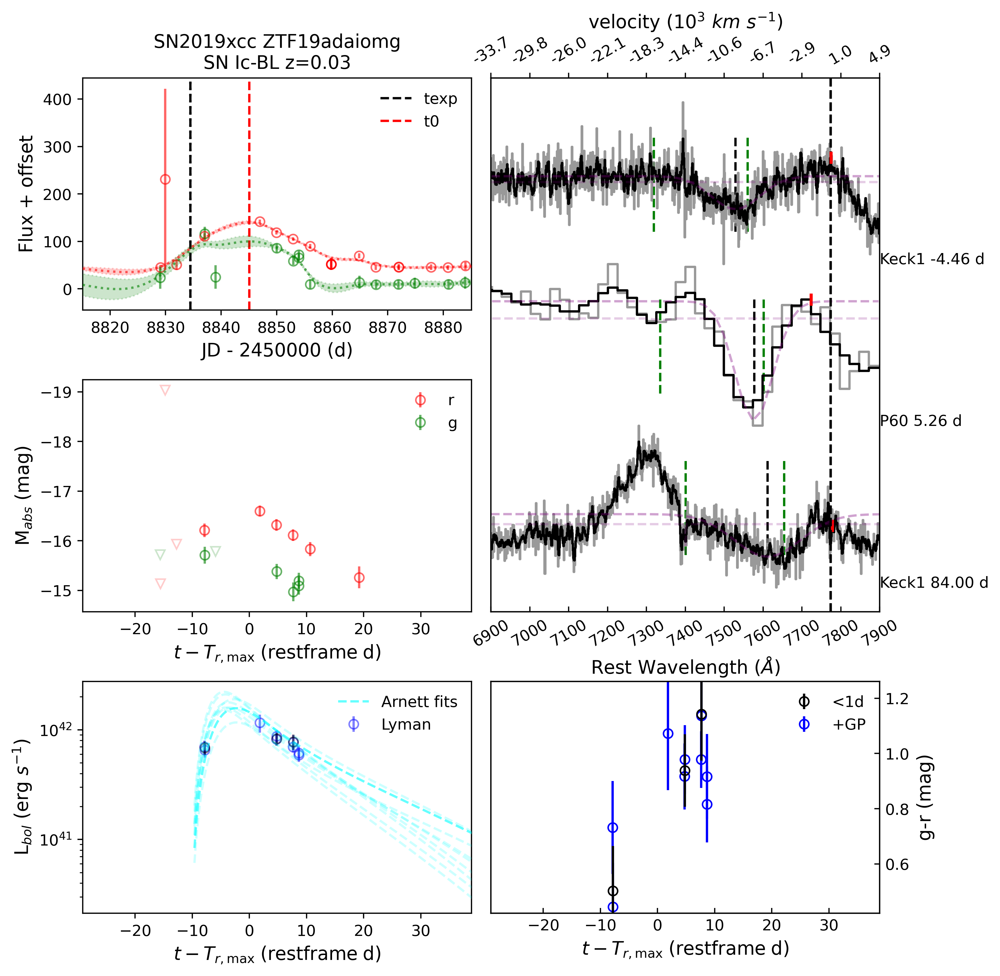

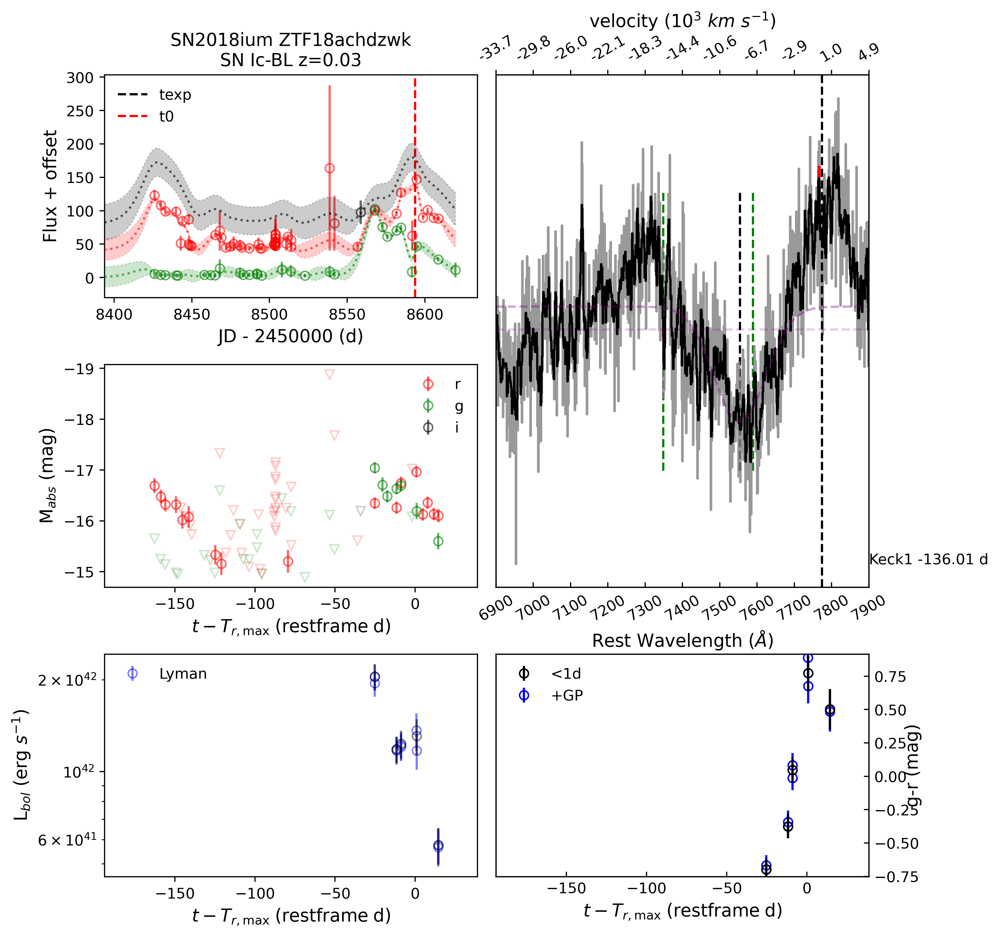

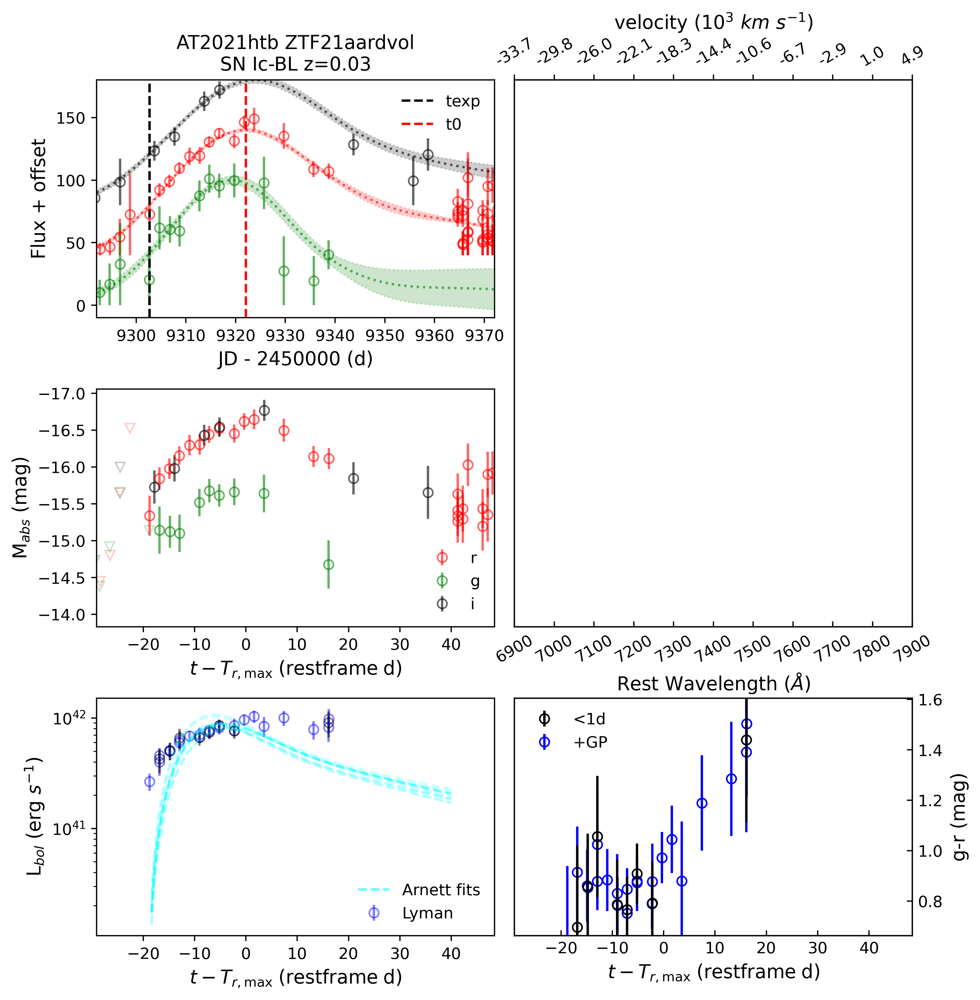

In [11]:
ztfpm.parse_params(force=True)
ztfpm.run(verbose=False, clobber=False, axes=None)

In [14]:
ztfpm.data['ZTF18acqphpd'].z

0.037000000000000005

ZTF19adaiomg & 2458845.09 & -16.58 (0.06) & -15.55 (0.24) & -10.62 $_{-2.51}^{2.51}$ & 0.04 $_{-0.01}^{0.01}$ & 5.04 $_{-0.95}^{1.36}$ & 0.66 $_{-0.12}^{0.18}$ & 0.68 (0.30) & 2.40 (1.14) \\


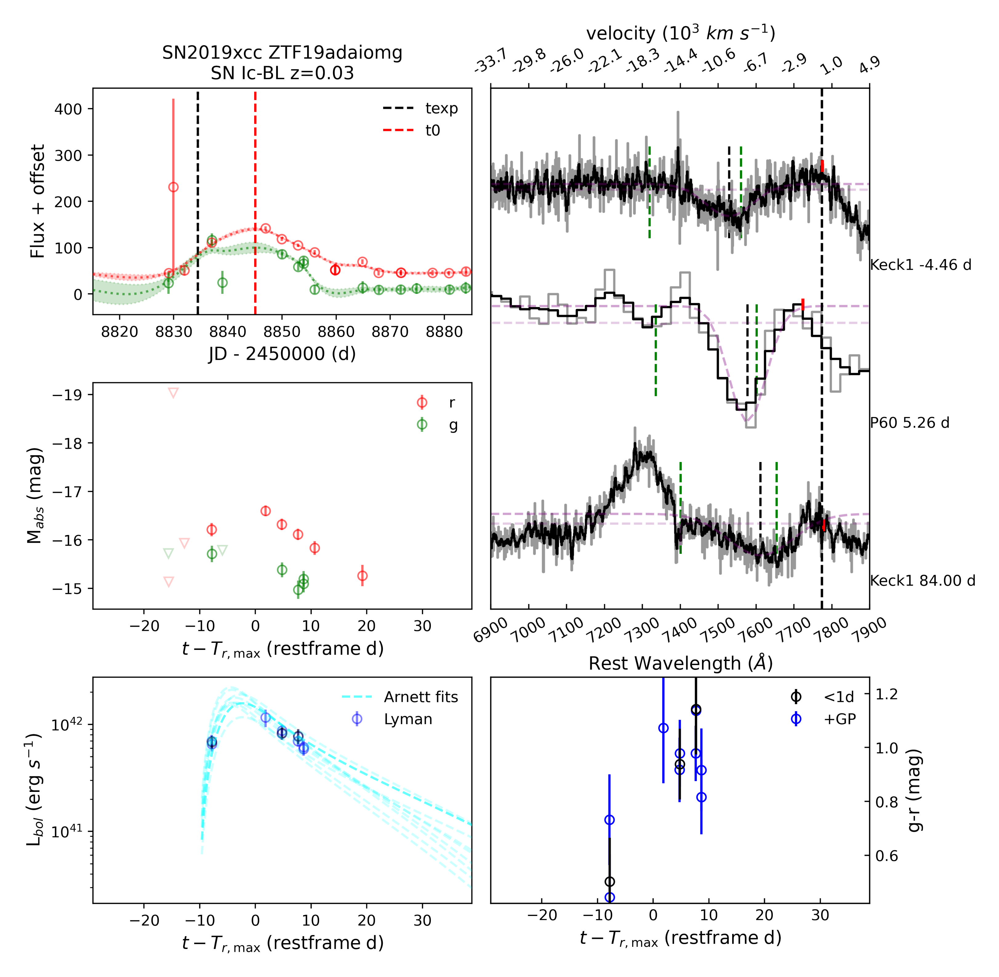

In [92]:
import os
for nsn in range(25):
    if nsn != 22:continue
    ztfid = ztfpm.meta.index[nsn]
    t0 = ztfpm.data[ztfid].t0
    tpeak = ztfpm.data[ztfid].tpeak
    fpeak = ztfpm.data[ztfid].fpeak
    fr,fre = fpeak['GP']['r']
    mr,mre,limmagr = ztfpm.data[ztfid].flux_to_mag(np.array([fr]), dflux=np.array([fre]), sigma=5, zp=23.9)
    fg,fge = fpeak['GP']['g']
    mg,mge,limmagg = ztfpm.data[ztfid].flux_to_mag(np.array([fg]), dflux=np.array([fge]), sigma=5, zp=23.9)
    mr -= ztfpm.data[ztfid].dm + (ztfpm.data[ztfid].mkwebv + ztfpm.data[ztfid].hostebv )* Rf['r']
    mg -= ztfpm.data[ztfid].dm + (ztfpm.data[ztfid].mkwebv + ztfpm.data[ztfid].hostebv )* Rf['g']
    try: 
        texp = ztfpm.data[ztfid].texp
    except: 
        print ( '!!!!', ztfid )
        continue
    if 'arnettcls' in ztfpm.data[ztfid].__dict__:
        art1 = ztfpm.data[ztfid].arnettcls.get_par()[0]
        art2 = ztfpm.data[ztfid].arnettcls.get_par()[1]
        art3 = ztfpm.data[ztfid].arnettcls.get_par()[2]
        mejek1 = taum_to_MejEk(art1[1], taumerr=None)
        mejek2 = taum_to_MejEk(art2[1], taumerr=None)
        mejek3 = taum_to_MejEk(art3[1], taumerr=None)
    else:
        art1, art2, art3= [-99, -99], [-99, -99], [-99, -99]
    ztfpm.data[ztfid].show()
    #figpath = '{}/{}'.format(ztfpm.data[ztfid].kwargs['datadir'], 
    #                     ztfpm.data[ztfid].kwargs['figpath']%ztfpm.data[ztfid].ztfid)
    #os.system ('cp %s ~/Desktop/' % figpath)
    
    #print ('\subsection{%s}\n'%ztfid)
    if art1[0] != -99: 
        if ztfid in velocities1:
            p,v,ve = velocities1[ztfid][0], velocities1[ztfid][1], velocities1[ztfid][2]
        else:
            p,v,ve = velocities2[ztfid][0], velocities2[ztfid][1], velocities2[ztfid][2]
        mej,meje,ek,eke = ztfpm.data[ztfid].taum_to_EM(vpeak=v/1000., vpeake=ve/1000., vopt=2)
        if abs(p) <= 15:
            print ( '%s & %.2f & %.2f (%.2f) & %.2f (%.2f) & %.2f $_{%.2f}^{%.2f}$ & %.2f $_{%.2f}^{%.2f}$ & %.2f $_{%.2f}^{%.2f}$ & %.2f $_{%.2f}^{%.2f}$ & %.2f (%.2f) & %.2f (%.2f) \\\\'
               % ( ztfid, t0, mr, mre, mg, mge, texp[1], texp[0]-texp[1], texp[2]-texp[1], art2[0], art1[0]-art2[0], art3[0]-art2[0], art2[1], art1[1]-art2[1], art3[1]-art2[1], mejek2, mejek1-mejek2, mejek3-mejek2, mej,meje,ek,eke ))
        else:
            print (p,v,ve)
            print ( '%s & %.2f & %.2f (%.2f) & %.2f (%.2f) & %.2f $_{%.2f}^{%.2f}$ & %.2f $_{%.2f}^{%.2f}$ & %.2f $_{%.2f}^{%.2f}$ & %.2f $_{%.2f}^{%.2f}$ & $>$ %.2f (%.2f) & $>$ %.2f (%.2f) \\\\'
               % ( ztfid, t0, mr, mre, mg, mge, texp[1], texp[0]-texp[1], texp[2]-texp[1], art2[0], art1[0]-art2[0], art3[0]-art2[0], art2[1], art1[1]-art2[1], art3[1]-art2[1], mejek2, mejek1-mejek2, mejek3-mejek2, mej,meje,ek,eke ))
    #    me2 = ztfpm.data[ztfid].taum_to_EM(vpeak=(v-ve)/1000., vpeake=None, vopt=2)
    #    print ( '%s, JD = %.2f, trise = %.2f d, v = %.1f (%.1f) km/s, Mni = %.2f Msun, taum = %.2f d \n\nwith v: Mej = %.2f Msun, Ek = %.2f foe\n\nwith v-ve: Mej = %.2f Msun, Ek = %.2f foe' % ( ztfid, t0, texp[1], v, ve, art[0], art[1], me1[0], me1[1], me2[0], me2[1] ))
    #else:
    #    print ( '%s, JD = %.2f, trise = %.2f d, v = None, Mni = %.2f Msun, taum = %.2f d' % ( ztfid, t0, texp[1], art[0], art[1]))
    #print ( '\n\\begin{figure}[H]\n\centering\n\includegraphics[width=.5\\textwidth]{fits/%s.png}\n\caption{}\n\end{figure}'%ztfid )
    #print ( '\n\n')
    

In [54]:
nsn = 2
ztfid = ztfpm.meta.index[nsn]
t0 = ztfpm.data[ztfid].t0
texp = ztfpm.data[ztfid].texp
art = ztfpm.data[ztfid].arnettcls.get_par()[1]
me1 = ztfpm.data[ztfid].taum_to_EM(vpeak=velocities[ztfid][2]/1000., vpeake=None, vopt=2)
me2 = ztfpm.data[ztfid].taum_to_EM(vpeak=(velocities[ztfid][2]-velocities[ztfid][3])/1000., vpeake=None, vopt=2)

print ('\subsection{%s}\n'%ztfid)

print ( '%s, JD = %.2f, trise = %.2f d, v = %.1f (%.1f) km/s, Mni = %.2f Msun, taum = %.2f d \n\nwith v: Mej = %.2f Msun, Ek = %.2f foe\n\nwith v-ve: Mej = %.2f Msun, Ek = %.2f foe' % ( ztfid, t0, texp[1], velocities[ztfid][2], velocities[ztfid][3], art[0], art[1], me1[0], me1[1], me2[0], me2[1] ))

print ( '\n\\begin{figure}[H]\n\centering\n\includegraphics[width=.5\\textwidth]{fits/%s.png}\n\caption{}\n\end{figure}'%ztfid )
#ztfpm.data[ztfid].corner(which='arnett_tail', limit=0.3,figpath='tmp')
#ztfpm.data[ztfid].corner(which='tail', limit=0.,figpath='tmp')

#ztfpm.data[ztfid].show()

\subsection{ZTF21aafnunh}

ZTF21aafnunh, JD = 2459252.52, trise = -15.92 d, v = 30451.1 (9516.6) km/s, Mni = 0.52 Msun, taum = 11.56 d 

with v: Mej = 4.52 Msun, Ek = 25.01 foe

with v-ve: Mej = 3.11 Msun, Ek = 8.13 foe

\begin{figure}[H]
\centering
\includegraphics[width=.5\textwidth]{fits/ZTF21aafnunh.png}
\caption{}
\end{figure}


2450948.1899995958


No handles with labels found to put in legend.


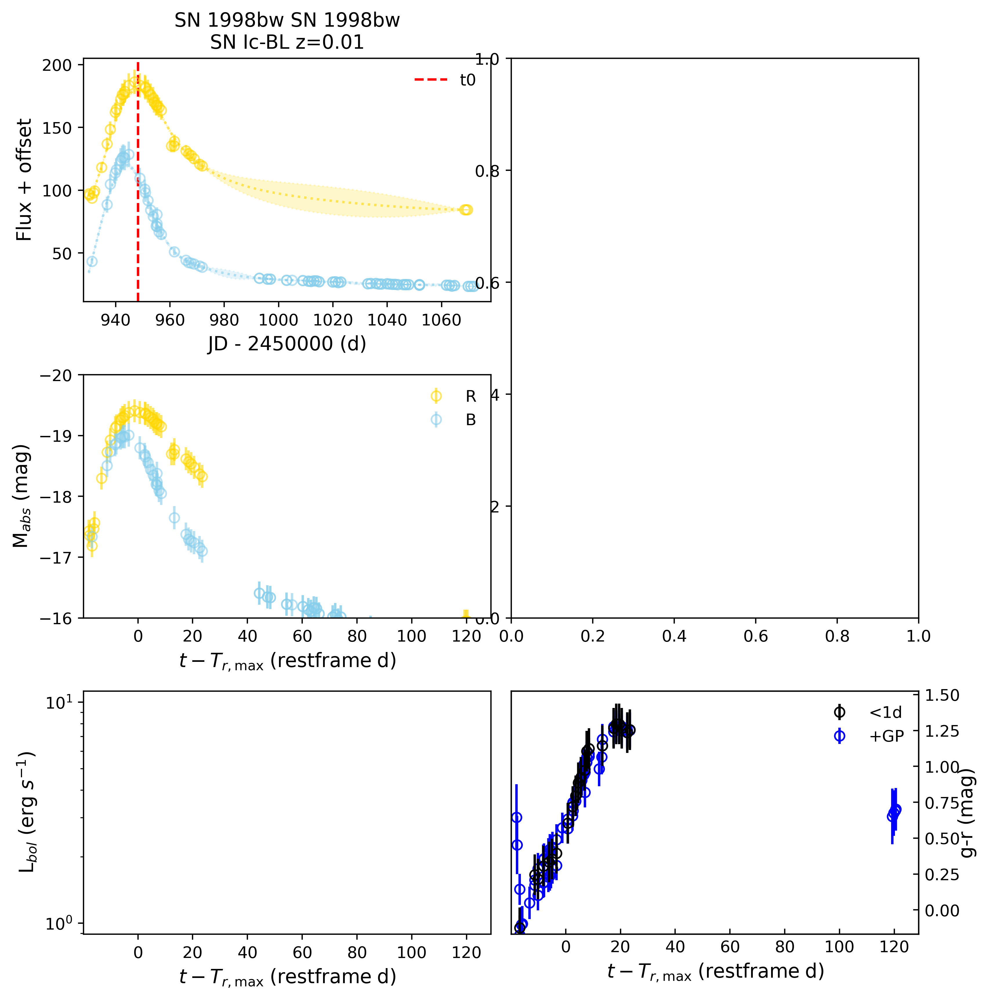

In [2]:
# parse 1998bw whose lc is taken from open sn catalog
sn1998bw_dist = cosmo.luminosity_distance( 0.0085 ).value
sn1998bw_dm = 5*np.log10(sn1998bw_dist)  + 25
sn1998bw_df = ztfsingle('SN 1998bw', iauid='SN 1998bw', z=0.0085,
                            mkwebv=0.0494, sntype='SN Ic-BL', dm=sn1998bw_dm, jdpeak=None,
                            axes=None,)    
sn1998bw_df.lc = pd.read_csv('/Users/yash0613/Library/CloudStorage/Box-Box/ztf_data/1998bw.txt',sep = ',').drop_duplicates()
sn1998bw_df.lc.rename(columns={'magnitude':'mag',
                       'e_magnitude':'emag',
                       'band':'filter'}, inplace=True)
sn1998bw_df.lc['jdobs'] = sn1998bw_df.lc['time'] + 2400000.5
sn1998bw_df.lc['emag'] = np.zeros(len(sn1998bw_df.lc['mag'])) + .1
sn1998bw_df.lc = sn1998bw_df.lc.query('filter in ["R","B"]')
sn1998bw_df.add_flux()
sn1998bw_df.clip_lc()
sn1998bw_df.check_lc()
sn1998bw_df.run_gp(gp_bands=['R','B'])
sn1998bw_df.set_t0_withgp(filt='R')
print (sn1998bw_df.t0)
sn1998bw_df.calc_colors(cfilt1='B', cfilt2='R')
sn1998bw_df.init_fig()
sn1998bw_df.plot(plot_bands=['R','B'], ax_xlim=[-20,130], ax2_ylim=[-16,-20])

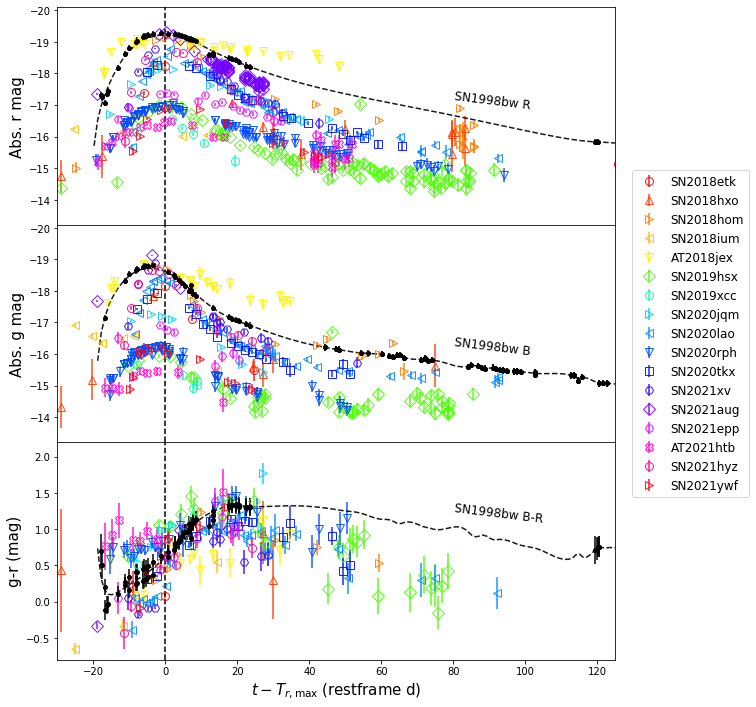

In [12]:
fig, (ax1,ax2,ax3) = plt.subplots(nrows=3, ncols=1)
plt.subplots_adjust(wspace = 0, hspace = 0)
markerlist = ['o','^','>','<','v','s','H','D','h','H','X']

for i, ztfid in enumerate(sorted(ztfpm.data)):
    if ztfid not in snlist2: continue
    cc = plt.get_cmap('hsv')(float(i)/(len(ztfpm.data)-1))
    mm = markerlist[i%len(markerlist)]
    lc = ztfpm.data[ztfid].lc
    t0 = ztfpm.data[ztfid].t0
    z = ztfpm.data[ztfid].z
    dm = ztfpm.data[ztfid].dm
    iauid = ztfpm.data[ztfid].iauid
    _lc = lc.query('filter=="r" and mag<99')
    ax1.errorbar( (_lc['jdobs']-t0)/(1+z), _lc['mag']-dm, yerr=_lc['emag'], ls='',
                 marker=mm, markersize=8, fillstyle='none', color=cc, label='%s'%(iauid), alpha=.9)
    _lc = lc.query('filter=="g" and mag<99')
    ax2.errorbar( (_lc['jdobs']-t0)/(1+z), _lc['mag']-dm, yerr=_lc['emag'], ls='',
                 marker=mm, markersize=8, fillstyle='none', color=cc, label='%s'%(iauid), alpha=.9)
    if 'colors' in ztfpm.data[ztfid].__dict__:
        gmr = ztfpm.data[ztfid].colors
        jdc, mg, mr, emg, emr = gmr[1]
        ax3.errorbar( (jdc-t0)/(1+z), mg-mr, yerr=np.sqrt(emg**2+emr**2), ls='',
                 marker=mm, markersize=8, fillstyle='none', color=cc, label='%s'%(iauid), alpha=.9)

# points
t0 = sn1998bw_df.t0
z = sn1998bw_df.z
dm = sn1998bw_df.dm
_lc=sn1998bw_df.lc.query('filter=="R" and mag<99')
ax1.errorbar( (_lc['jdobs']-t0)/(1+z), _lc['mag']-dm, yerr=_lc['emag'], ls='',
                 marker='o', markersize=4, color='k')
_lc=sn1998bw_df.lc.query('filter=="B" and mag<99')
ax2.errorbar( (_lc['jdobs']-t0)/(1+z), _lc['mag']-dm, yerr=_lc['emag'], ls='',
                 marker='o', markersize=4, color='k')
gmr = sn1998bw_df.colors
jdc, mg, mr, emg, emr = gmr[3]
ax3.errorbar( (jdc-t0)/(1+z), mg-mr, yerr=np.sqrt(emg**2+emr**2), ls='',
                 marker='o', markersize=4, color='k')

# GP
sn1998bw_df.gpcls.predict(x_pred=np.arange(sn1998bw_df.t0-40, sn1998bw_df.t0+130), clobber=True)
__ = np.where(sn1998bw_df.gpcls.f_pred=='R')
xx = sn1998bw_df.gpcls.x_pred[__]
pp = (xx-sn1998bw_df.t0) / (1+sn1998bw_df.z)
yy = sn1998bw_df.gpcls.y_pred[__]
mm1 = sn1998bw_df.flux_to_mag(yy, dflux=None)
ax1.plot( pp, mm1-sn1998bw_df.dm, ls='--', marker='', color='k', alpha=.9)

__ = np.where(sn1998bw_df.gpcls.f_pred=='B')
xx = sn1998bw_df.gpcls.x_pred[__]
pp = (xx-sn1998bw_df.t0) / (1+sn1998bw_df.z)
yy = sn1998bw_df.gpcls.y_pred[__]
mm2 = sn1998bw_df.flux_to_mag(yy, dflux=None)
ax2.plot( pp, mm2-sn1998bw_df.dm, ls='--', marker='', color='k', alpha=.9)

ax3.plot( pp, mm2-mm1, ls='--', marker='', color='k', alpha=.9)

for ax in [ax1,ax2,ax3]: 
    ax.set_xlim([-30,125])
    ax.axvline(0,color='k',ls='--')
for ax in [ax1,ax2]: ax.set_ylim([-13.21,-20.1])
ax3.set_ylim([-.8,2.2])

ax1.text(80,-16.9,'SN1998bw R', fontsize=12, rotation=-7)
ax2.text(80,-16.0,'SN1998bw B', fontsize=12, rotation=-7)
ax3.text(80,1.1,'SN1998bw B-R', fontsize=12, rotation=-7)

ax1.set_xticks([])
ax2.set_xticks([])

ax1.legend(loc = 'center right', bbox_to_anchor = (1.25, -0.5), 
           ncol=1, numpoints=1, fontsize=12, frameon=True)
ax3.set_xlabel('$t - T_{r,\mathrm{max}} \; (\mathrm{restframe \; d})$',fontsize=15)
ax1.set_ylabel('Abs. r mag',fontsize=15)
ax2.set_ylabel('Abs. g mag',fontsize=15)
ax3.set_ylabel('g-r (mag)',fontsize=15)

fig.set_size_inches(10,12)
plt.show()
fig.savefig('/Users/yash0613/Desktop/scripts/sn_data_analysis/lcs_mag.png', bbox_inches='tight')

# start with one object
### test with ZTF21abmjgwf for example, get parameter that was needed, i.e. z, ebv and distance module

In [6]:
ztfid = 'ZTF21abmjgwf'
print (ztfpm.meta['redshift'][ztfid], ztfpm.meta['dm'][ztfid], 
       ztfpm.meta['ebv'][ztfid], ztfpm.meta['peakt'][ztfid] + 2458000, )

0.07 37.56538692164344 0.055161290322580644 2459430.84


### OK, now start a ztfsingle class with z, ebv and dm

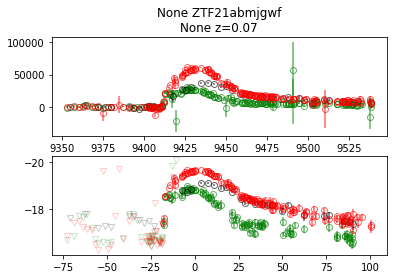

In [7]:
# initialize class
ztfp = ztfsingle(ztfid=ztfid, z=ztfpm.meta['redshift'][ztfid], 
                 dm=ztfpm.meta['dm'][ztfid], mkwebv=ztfpm.meta['ebv'][ztfid],
                 jdpeak=ztfpm.meta['peakt'][ztfid] + 2458000)

# get forced lightcurves
ztfp.get_local_forced_lightcurves()

# calculate Fmcmc and Fmcmc_unc from mags
ztfp.add_flux()

# check lc infos
#ztfp.check_lc(verbose=True, jdthre=1, plot_bands=['g','r','i'])

# create 2 plots
fig,(ax, ax2)=plt.subplots(2,1)
ztfp.ax = ax
ztfp.ax2 = ax2

# show
ztfp.plot(plot_bands=['g','r','i'])

### run gaussian process intepolation, to decide t0 as r band peak jd

t0 =  2459430.84
after GP, t0 =  2459434.5964453984


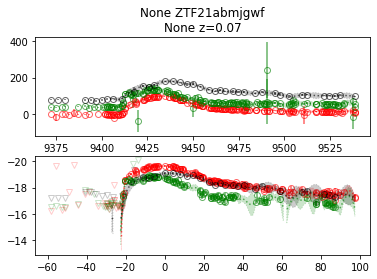

In [8]:
ztfp.run_gp(gp_type=1, 
            gp_routine='mcmc', 
            gp_mean='bazin', 
            kernel='matern32', 
            fix_scale=True,
            gp_fitr=[-60, 120], 
            gp_plotr=[-30, 120], 
            gp_bands=['g','r','i']
           )
print ('t0 = ',ztfp.t0)

ztfp.set_t0_withgp(filt='r') # set t0 with GP in r band
print ('after GP, t0 = ',ztfp.t0)

fig,(ax, ax2)=plt.subplots(2,1)
ztfp.ax = ax
ztfp.ax2 = ax2

ztfp.plot(plot_bands=['r', 'g', 'i'])

### fits sn lc in g, r, and i to Bazin et al 2009, with emcee

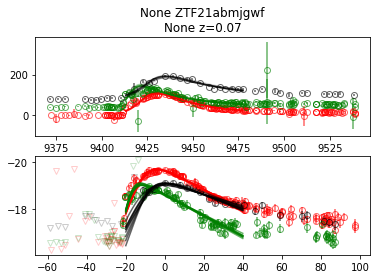

In [9]:
ztfp.run_fit(fit_type=1, 
            fit_routine='mcmc', 
            fit_bands=['i','g','r'],
            fit_mean='bazin', 
            fit_fitr=[-50, 50], 
            fit_plotr=[-50, 120], 
            nsteps=20000,
            nsteps_burnin=2000,
            verbose=False
           )
fig,(ax, ax2)=plt.subplots(2,1)
ztfp.ax = ax
ztfp.ax2 = ax2
ztfp.plot(gp_type=3, plot_bands=['r', 'g', 'i'])

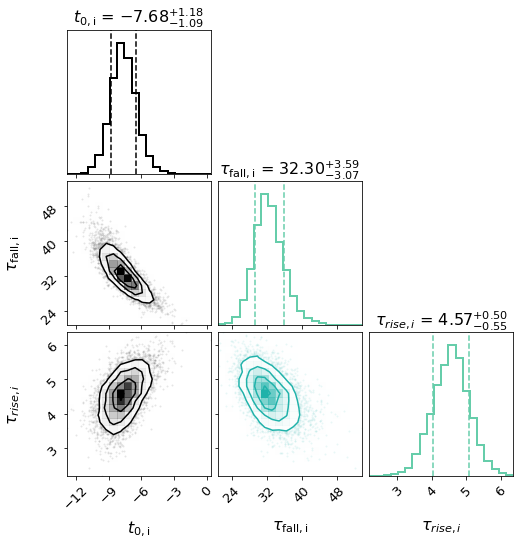

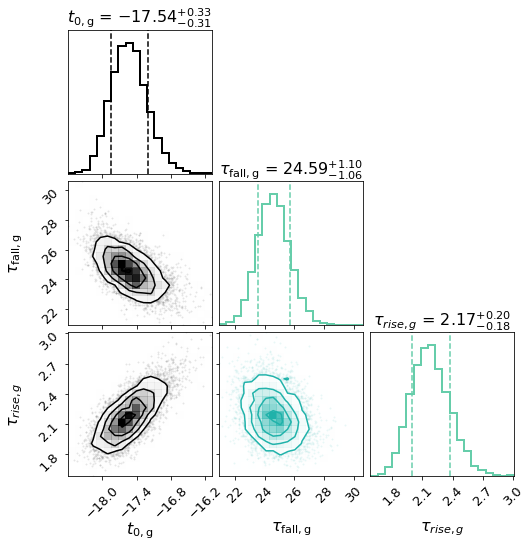

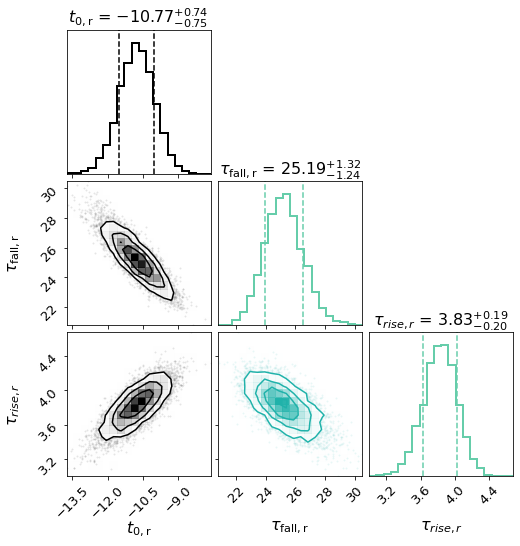

In [10]:
#parameter distribution
ztfp.corner(show=True, which='fit')

### the sn lc fits can be also done with scipy.optimize, which is faster but not that good...

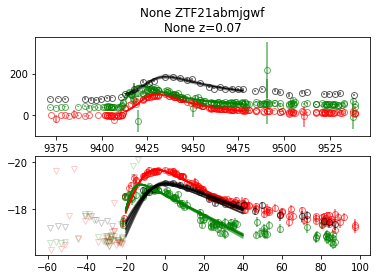

In [11]:
ztfp.run_fit(fit_type=1, 
            fit_routine='trf', 
            fit_bands=['r', 'g', 'i'],
            fit_mean='bazin', 
            fit_fitr=[-50, 50], 
            fit_plotr=[-50, 120], 
            nsteps=100,
            verbose=False
           )
fig,(ax, ax2)=plt.subplots(2,1)
ztfp.ax = ax
ztfp.ax2 = ax2
ztfp.plot(gp_type=3, pl_type=3, plot_bands=['r', 'g', 'i'],)

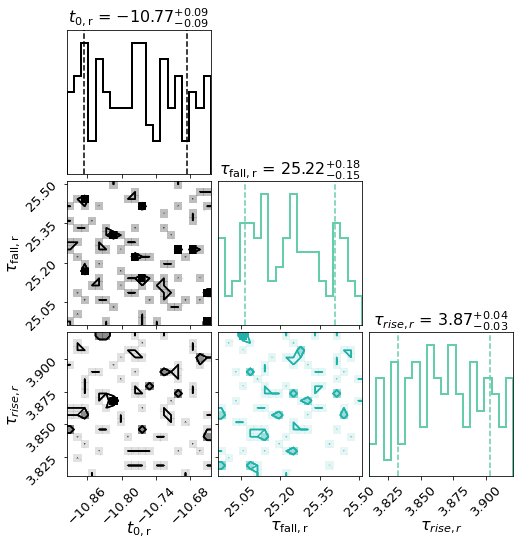

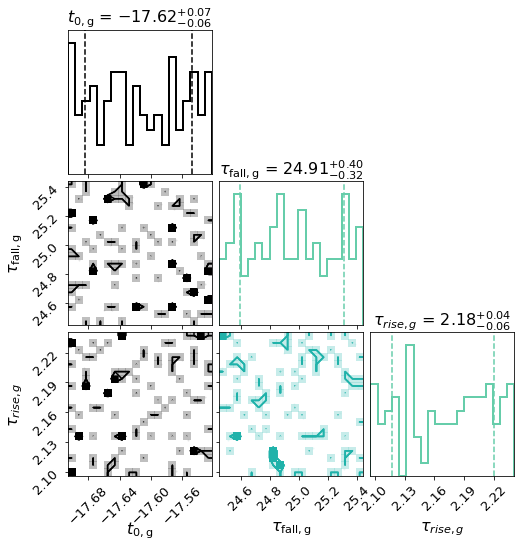

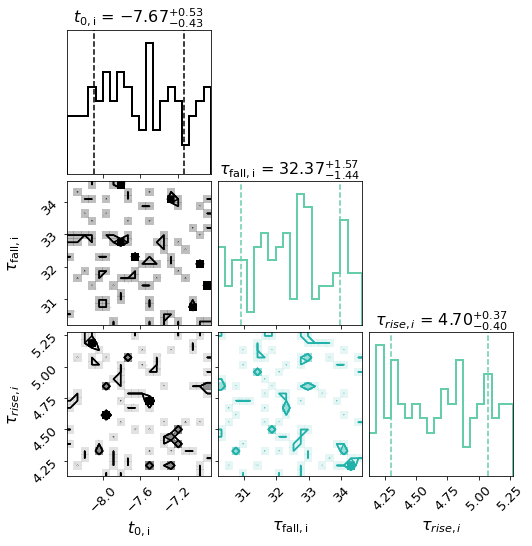

In [12]:
# parameter distribution
ztfp.corner(show=True, which='fit')

### run power law on early phase LCs simultaneously, to decide first light epoch

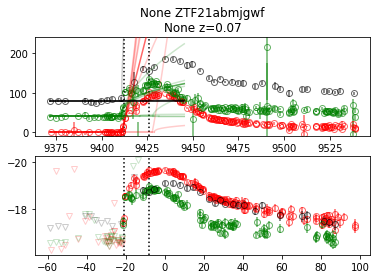

In [13]:
ztfp.explosion_pl(pl_type=1, 
            pl_routine='mcmc', 
            pl_bands=['r', 'g', 'i'],
            nsteps=20000,
            nsteps_burnin=5000,
            nwalkers=100,
            rel_flux_cutoff=.4,
            verbose=False,
           )
fig,(ax, ax2)=plt.subplots(2,1)
ztfp.ax = ax
ztfp.ax2 = ax2
ztfp.plot(gp_type=3, fit_type=3, pl_plotmax=10, ax_ylim=[-10,240],
          plot_bands=['r', 'g', 'i'], pl_bands=['r', 'g', 'i'])

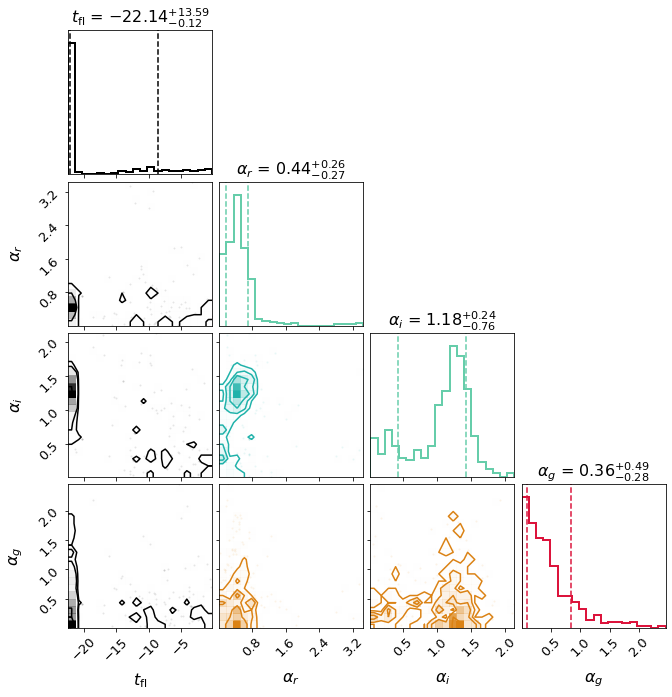

In [14]:
#parameter distribution
ztfp.corner(show=True, which='pl', pl_bands=['r','i','g'])

### make bolometric LCs
#### 1. decide g-r               
#### 2. BC_g from Lyman et al, to Mbol

In [15]:
# 1: colors with both filter available within 24 hours
# 2: epochs with one band available, and the other from fit intepolated
# 3: epochs with one band available, and the other from GP intepolated
ztfp.calc_colors(gmr=[1,], filt1='g', filt2='r', color_thre=24)

In [16]:
# ignore host ebv for Ic BL
ztfp.hostebv = 0
ztfp.sntype = 'SN Ic-BL'

In [17]:
ztfp.lyman_bol() # calculate bolometric LC with g and r, based on Lyman et al 2014

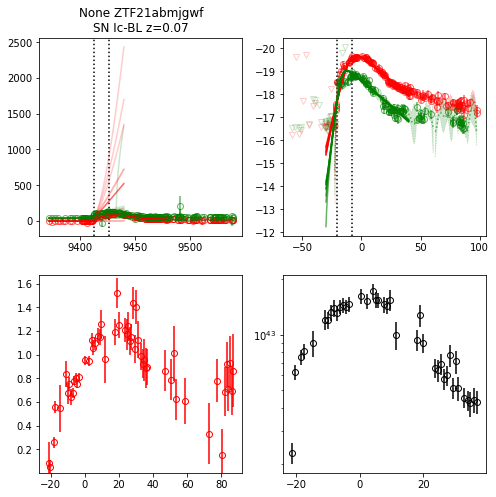

In [18]:
fig,((ax, ax2), (ax3,ax4))=plt.subplots(2,2,figsize=(8,8))
ztfp.ax = ax
ztfp.ax2 = ax2
ztfp.ax3 = ax3
ztfp.ax4 = ax4
ztfp.plot(fit_plotr=[-30, 40], gmr=[1],)

### Arnett fits on Mni and taum in monte carlo mode

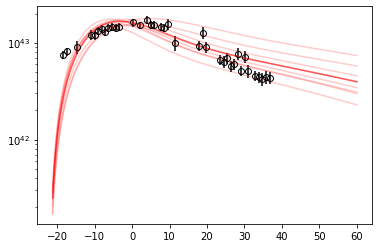

In [19]:
ztfp.arnett_fit(Arnett_type=1, 
            Arnett_style=1,
            Arnett_routine='mcmc',  
            Arnett_fitr=[-30, 40], 
            fit_plotr=[-50, 120], 
            nsteps=20000,
            nsteps_burnin=2000,
            verbose=False
           )
fig,ax=plt.subplots(1,1)
ztfp.ax4 = ax
ztfp.plot(gmr=[1])

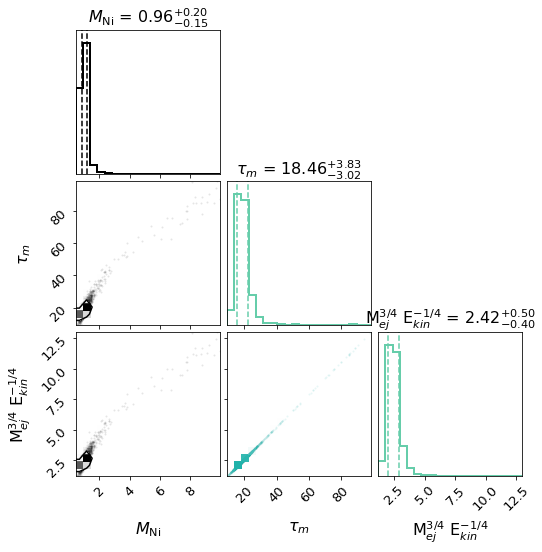

In [20]:
# parameter distribution
ztfp.corner(show=True, which='arnett',)

### Arnett fits on Mni, Ek and Mej with exlosion epoch as free parameter on MC mode

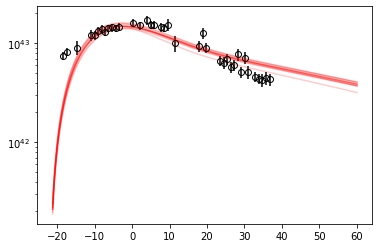

In [25]:
ztfp.arnett_fit(Arnett_type=1, 
            Arnett_style=3,
            Arnett_routine='mcmc',  
            Arnett_fitr=[-30, 40], 
            fit_plotr=[-50, 120], 
            nsteps=200,
            verbose=False
           )
fig,ax=plt.subplots(1,1)
ztfp.ax4 = ax
ztfp.plot(gmr=[1])

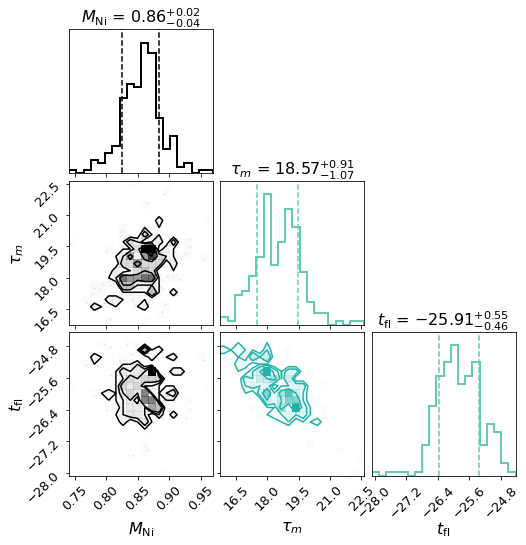

In [26]:
# parameter distribution
ztfp.corner(show=True, which='arnett_fitt',)

### Arnett fits on Mni, Ek and Mej with exlosion epoch as free parameter with scipy

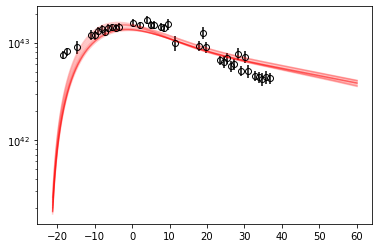

In [27]:
ztfp.arnett_fit(Arnett_type=1, 
            Arnett_style=3,
            Arnett_routine='trf',  
            Arnett_fitr=[-30, 40], 
            fit_plotr=[-50, 120], 
            nsteps=200,
            verbose=False
           )
fig,ax=plt.subplots(1,1)
ztfp.ax4 = ax
ztfp.plot(gmr=[1])

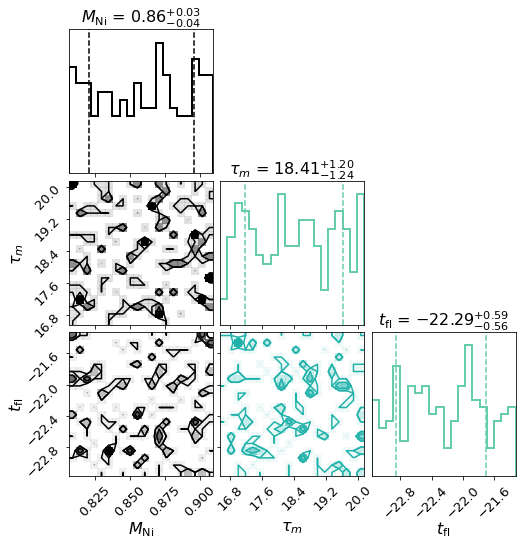

In [28]:
# parameter distribution
ztfp.corner(show=True, which='arnett_fitt',)

### Arnett fits on Mni and taum with scipy

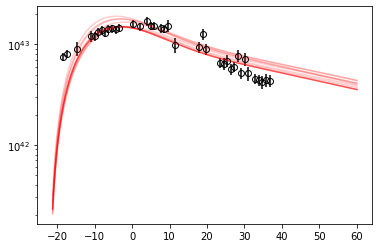

In [29]:
ztfp.arnett_fit(Arnett_type=1, 
            Arnett_style=1,
            Arnett_routine='trf',  
            Arnett_fitr=[-30, 40], 
            fit_plotr=[-50, 120], 
            nsteps=1000,
            verbose=False
           )
fig,ax=plt.subplots(1,1)
ztfp.ax4 = ax
ztfp.plot(gmr=[1])

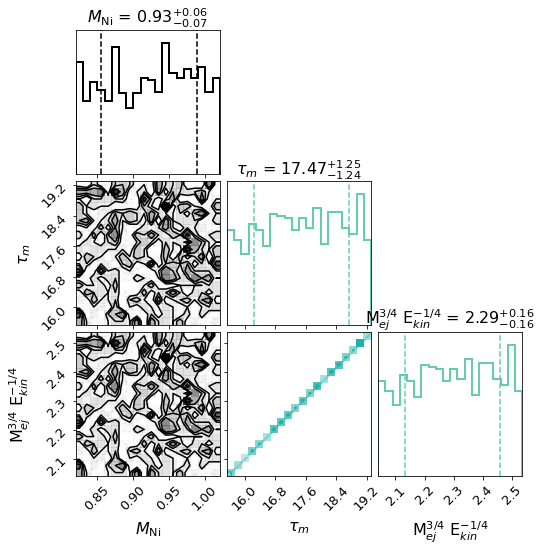

In [30]:
# parameter distribution
ztfp.corner(show=True, which='arnett',)

# for all object

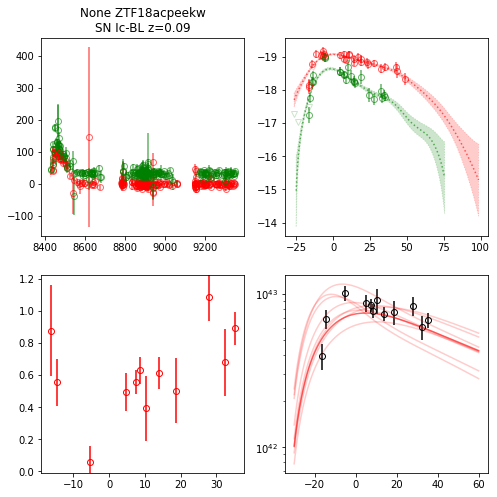

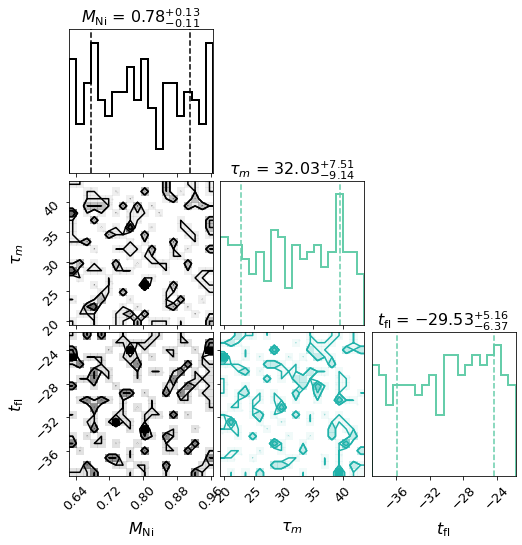

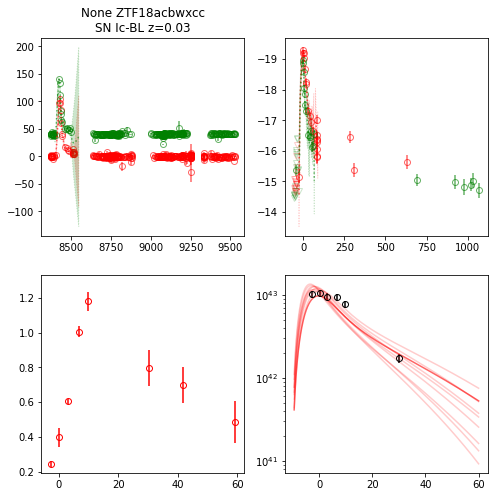

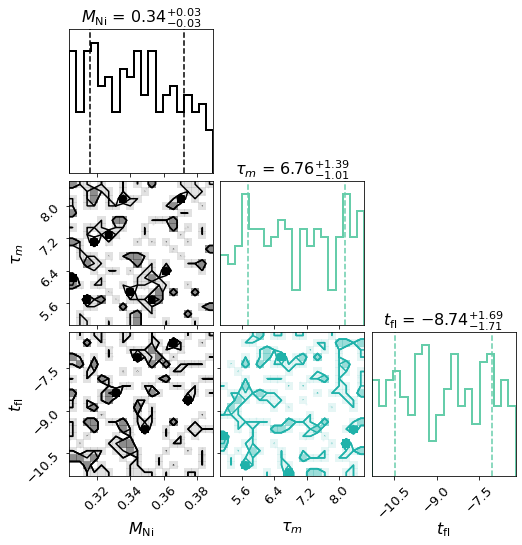

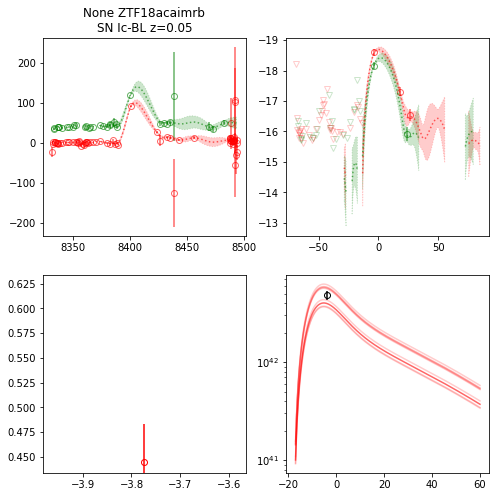

...

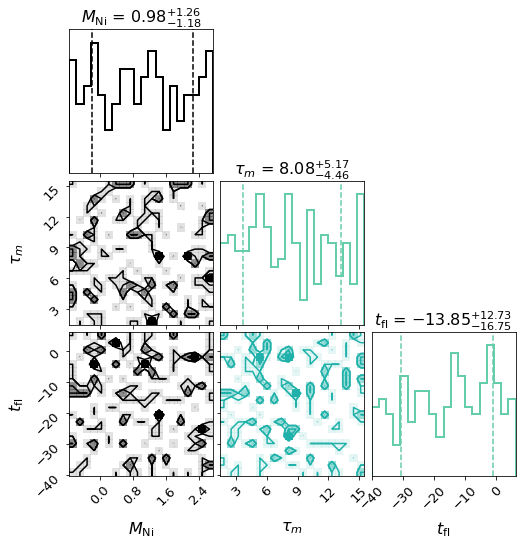

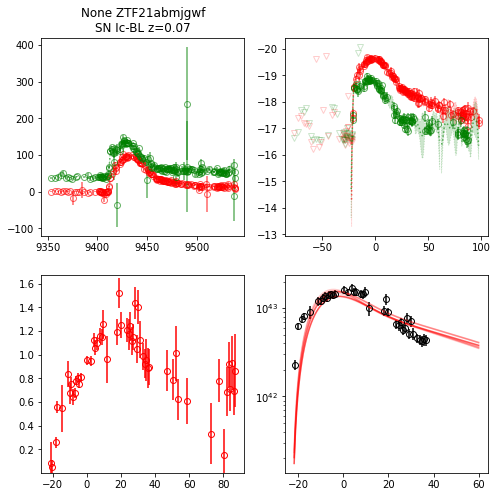

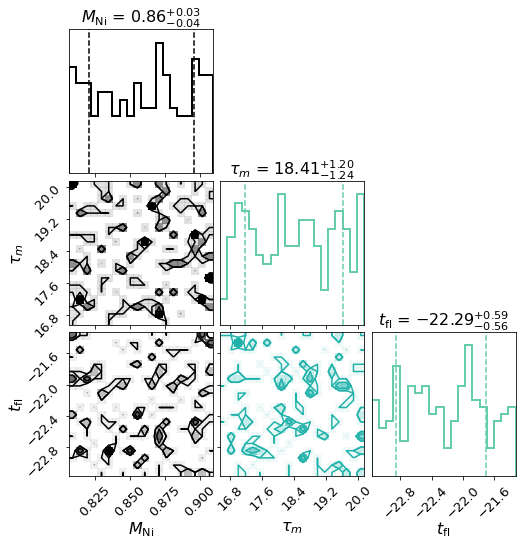

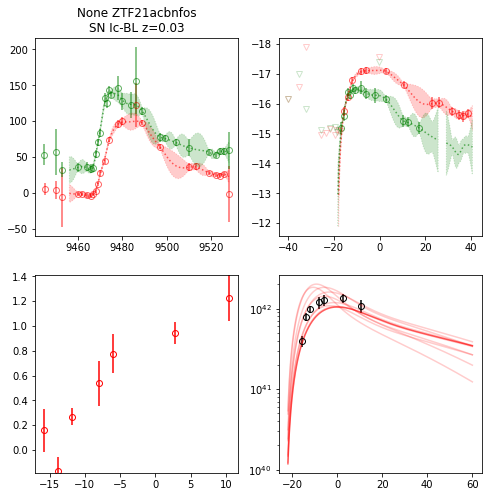

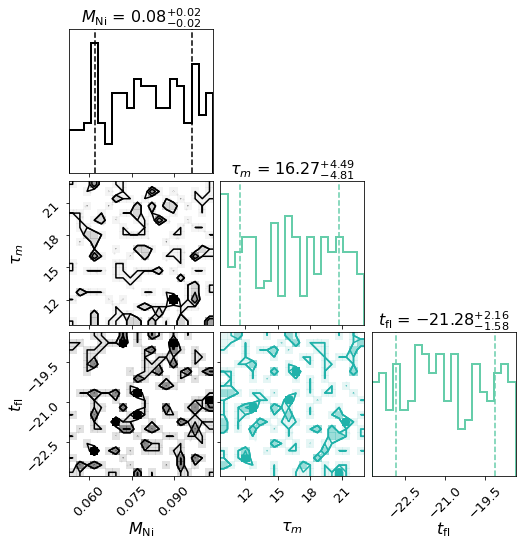

In [19]:
for n, ztfid in enumerate(snlist1):
    #if n > 3:continue
    #print (ztfid)
    ztfp = ztfsingle(ztfid=ztfid, z=ztfpm.meta['redshift'][ztfid], 
                 dm=ztfpm.meta['dm'][ztfid], mkwebv=ztfpm.meta['ebv'][ztfid],)
    ztfp.get_local_forced_lightcurves()
    ztfp.add_flux()
    ztfp.run_gp(gp_type=1, 
            gp_routine='minimize', 
            gp_mean='bazin', 
            kernel='matern32', 
            fix_scale=True,
            gp_fitr=[-60, 120], 
            gp_plotr=[-30, 120], 
            gp_bands=['g','r',]
           )
    ztfp.set_t0_withgp(filt='r')
    ztfp.calc_colors(gmr=[1,], filt1='g', filt2='r', color_thre=24)
    ztfp.hostebv = 0
    ztfp.sntype = 'SN Ic-BL'
    ztfp.lyman_bol()
    
    ztfp.arnett_fit(Arnett_type=1, 
            Arnett_style=3,
            Arnett_routine='trf',  
            Arnett_fitr=[-30, 40], 
            fit_plotr=[-50, 120], 
            nsteps=200,
            verbose=False
           )

    fig,((ax, ax2), (ax3,ax4))=plt.subplots(2,2,figsize=(8,8))
    ztfp.ax = ax
    ztfp.ax2 = ax2
    ztfp.ax3 = ax3
    ztfp.ax4 = ax4
    ztfp.plot(fit_plotr=[-30, 40], gmr=[1],)
    
    ztfp.corner(show=True, which='arnett_fitt',)
    #break